# Generative Adversarial Networks 
Based on tutorials by Ian Goodfellow et al.






### By Jeremy Hartmann 

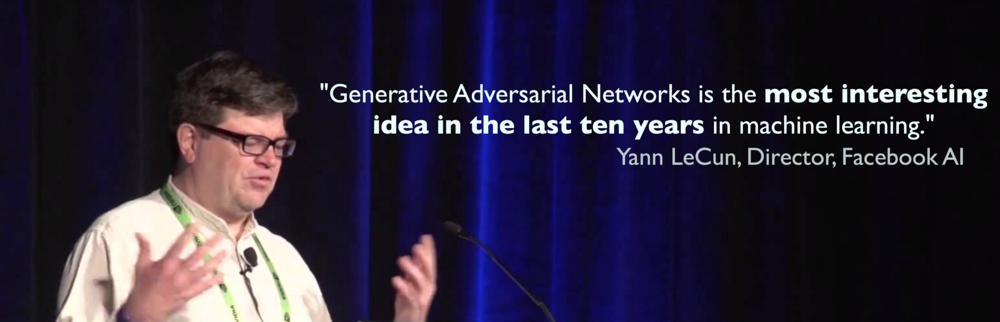

# Summary

- Motivation
- What are GANs?
- Current Issues
- Research Frontiers



# Motivation

- Simulate many possible futures for planning or simulated RL (Reinforcement Learning)
- Semi-Supervised learning (Missing data)
- Multi-model output
- Realistic generation tasks

### Interactive Image Generation (Zhu et al. 2016)

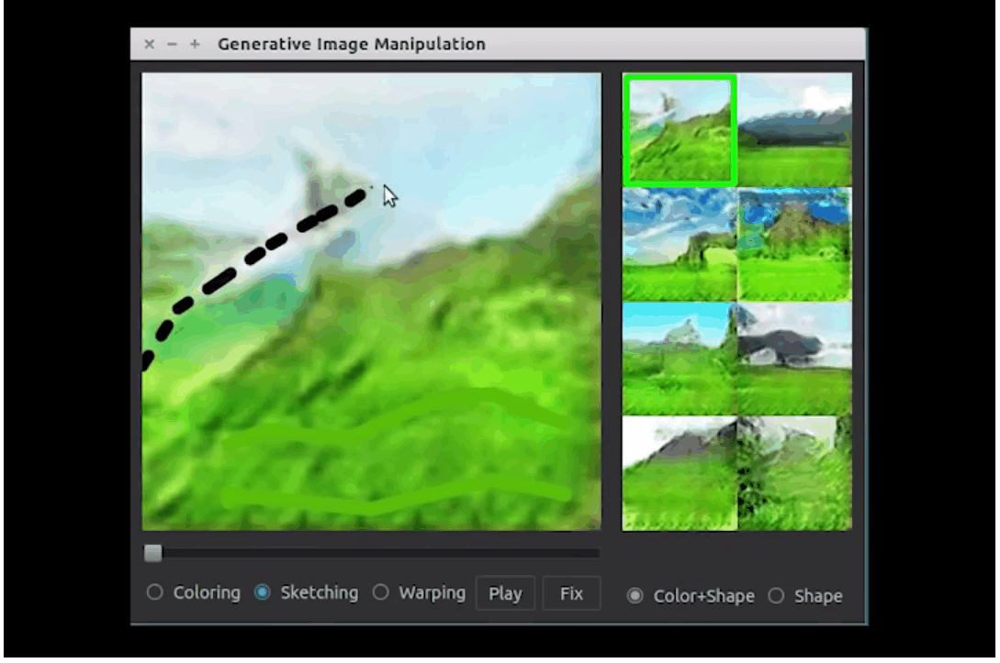

### Super Resolution GAN (Ledig et al. 2015)

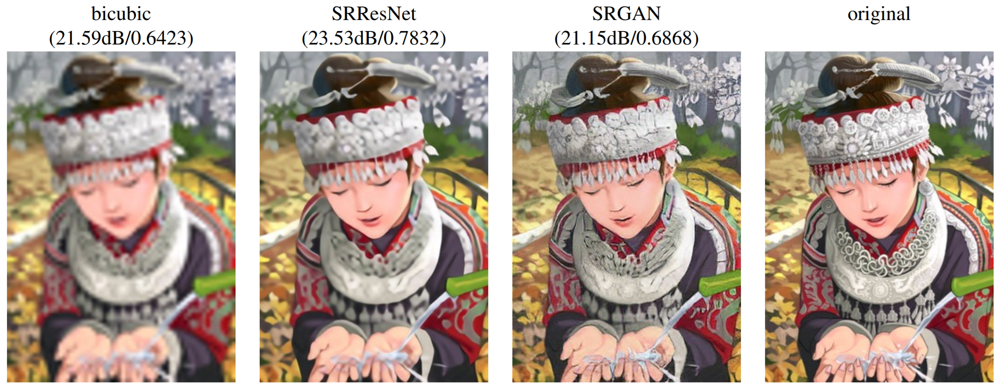

### 3D GAN (Wu et al. 2016)
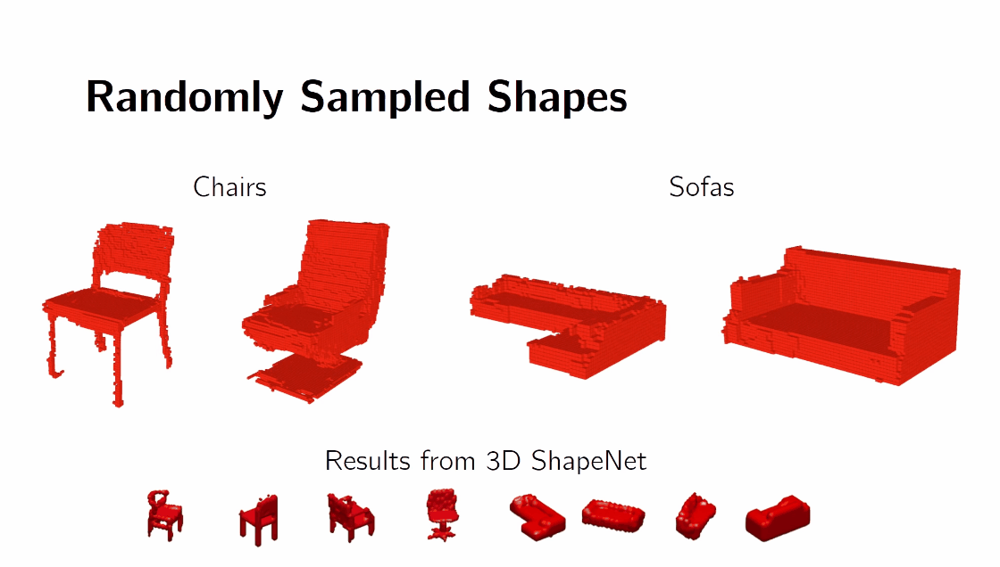

# What are GANs?

Generator: 
- samples from the prior distribution of the latent space. 
- Latent space -- essential some randomness to produce images. 
- Generates samples for a minibatch is fed into the discriminator
- Usually is some form of deconvolution (transpose stride) net. 

Discriminator:
- essentially a binary classifier that determines weather the input is fake or real
- Can be a feed-forward (ConvNet)

Simultaneous Gradient Descent
- Both minibatches are processed. 
- And both the generator and discriminator will update there weights based on the cost function. 



### The Latent Space
- Source of randomness but more meaningful. 
- High dimensional vector space of the real data's manifold. 

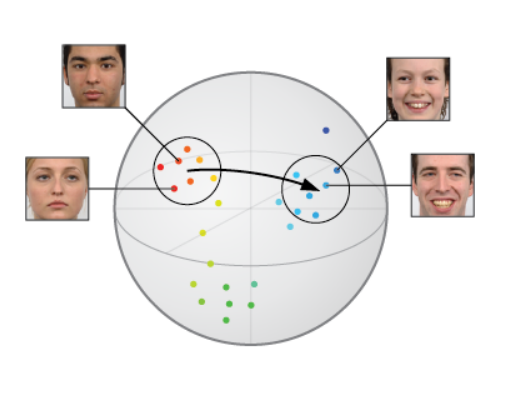

The high dimension data:
- Could be categories like gender, smiling, etc....
- People wearing glasses. 
- Image: (Tom White, 2016)


### Vector Arithmetic on the Latent Space

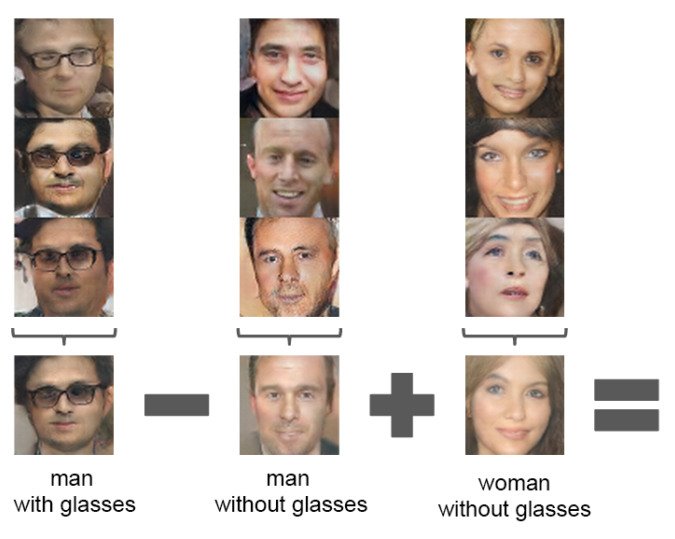


Vector arithmetic:
- Alec Radford et al. 2016 LCLR. 
- Introduced DCGAN (Deep Convolutional GAN)

- have a representation of a man with glasses
- have a representaion of a man without glasses. 
- Plus a women without glasses

- Theses are the vectors in the latent space. 

What do we get?

### Vector Arithmetic

- Women with glasses (obviously!)

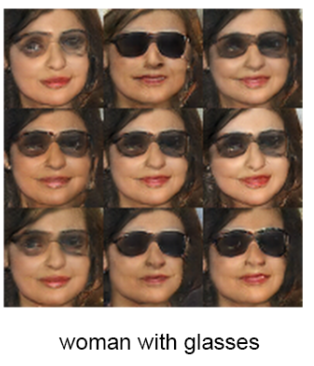

- Easy to understand at a high level
- Lots of intrecracies at the low level
- Many interesting research questions (later...)

# Taxonomy of Generative Models

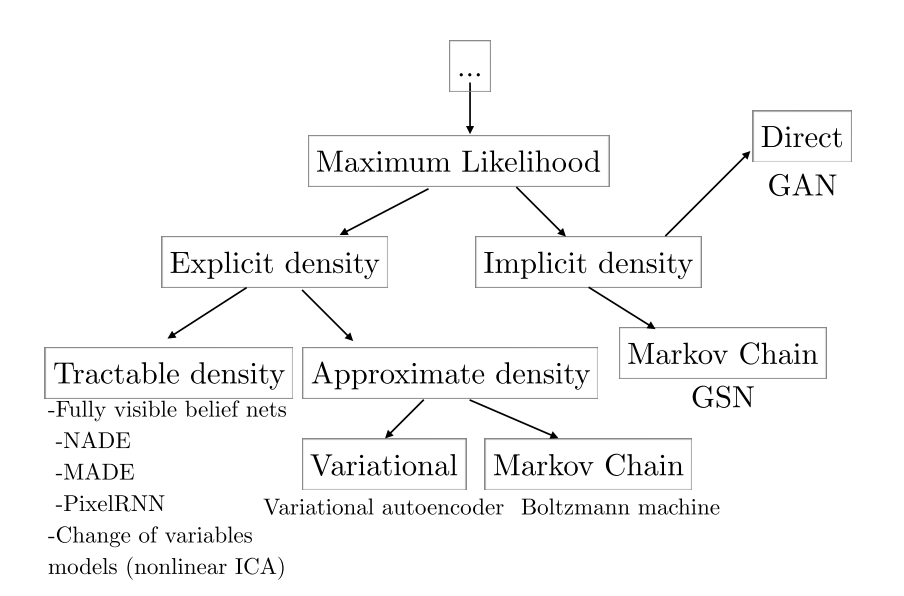

Taxonomy of Generative Models:
- The three most popular generative models are 
 - FVBN (Fully Visible Belief Nets) - WaveNet
 - GAN (What we are discussing!)
 - Variational Autoencoders
 
 
- Explicit Models
 - Captures all the complexity of the model. 
 - Fairly straight forward to train, plug the model definition of the density function into the expression for the likelihood and follow the gradient uphill. 
 - Tractabile (model is computationally computatble)
 - Approximate (need to invoke some kinde of Monte Carlo or variational approximation). 
 
 
- Implicit Models
  - Does not explicitly represent the probability distrubution over the space where the data lies. 
  - Provides a means to interact less directly usually by sampling from it. 
  - Generative Stochastic Network (Bengio et al. 2014). 
  

### Fully Visible Belief Nets (FVBN) - WaveNet (Oord et al. 2016)
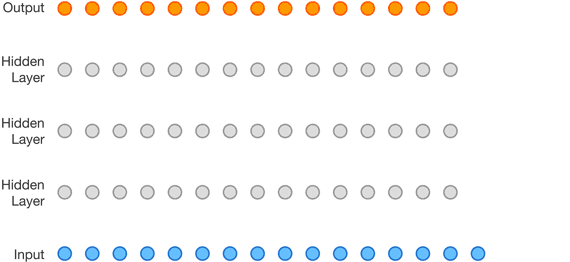

Disadvantage:
- (FVBN) Not parallel - GANs can generate all samples in parallel. 
- Each sample is generated sequentially. 2 min for 1 seccond of audio. 


### Variational AutoEncoders (Kingma et al. 2013)
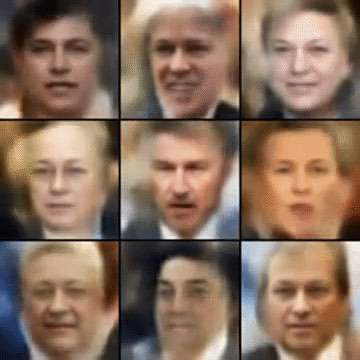

Variational Autoencoders:
- Produce blurry images and lower quality samples (GANs produce subjectivly better examples, hard to prove)
- Might not be asymptotically consistent (Yet to be proven). 

# Cost Function

### Discriminator
   $J^{(D)} (\theta^{(D)}, \theta^{(G)}) = -\frac{1}{2} \mathbb{E}_{x \sim p_{data}} \log{(D(x))} - \frac{1}{2} \mathbb{E}_{z} \log{(1 - D(G(z)))}$

The Cost Function
- What's happening here is really interesting. 
- It is a standard cross entropy cost that is minimized when training a standard binary classifier. 

### The real samples
# $-\frac{1}{2} \mathbb{E}_{x \sim p_{data}} \log{(D(x))}$

Here we have the expected value of x from the data probability distrubition which are our real images. 
- This could be from MNIST, ImageNet etc....

### Latent Space Samples
# $- \frac{1}{2} \mathbb{E}_{z} \log{(1 - D(G(z)))}$

This is the expect value z over the prior probability distrubition of the latent space. 
- Z is a source of noise for the generator. 
- the latent space can be larger or smaller then x. 


### Another View

### $\nabla_{\theta_d} \frac{1}{m} \sum^{m}_{i=1} \big[ \log{D(x^{(i)})} + \log{(1 - D(G(z^{(i)})}) \big]$

Crux: the cost function for the discriminator takes a minibatch from the Generator and a minibatch from the real data distrubution. 

- Medium article from Julien ref at end. 
- Gradient ascent (maximize!)



### Minimax Game

- zero-sum Game

 $J^{(D)} = -\frac{1}{2} \mathbb{E}_{x \sim p_{data}} \log{(D(x))} - \frac{1}{2} \mathbb{E}_{z} \log{(1 - D(G(z)))}$
 
 $J^{(G)} = -J^{(D)}$
 
- Where the saddle point is the Nash equilibrium.  
- Generator minimizes the log probability of the discriminator being correct

Minimax Game
- The generator recieves the negative of what the discriminator gernerates
- The equilbrium is the saddle point of the discriminator loss
- Rembles the Jensen-Shannon divergence instead of the KL divergence. 
- Heurstics are used to help the generator and avoid non-convergence. (Paper)
- Issues are created by this as the minmax is not garunteed and could form a maxmin....
 - Mode collapse problem (later..)

### How does this work in code...

In [ ]:
#These two placeholders are used for input into the generator and discriminator, respectively.
z_in = tf.placeholder(shape=[None,z_size],dtype=tf.float32) #Random vector
real_in = tf.placeholder(shape=[None,32,32,1],dtype=tf.float32) #Real images

Gz = generator(z_in) #Generates images from random z vectors
Dx = discriminator(real_in) #Produces probabilities for real images
Dg = discriminator(Gz,reuse=True) #Produces probabilities for generator images

#These functions together define the optimization objective of the GAN.
d_loss = -tf.reduce_mean(tf.log(Dx) + tf.log(1.-Dg)) #This optimizes the discriminator.
g_loss = -tf.reduce_mean(tf.log(Dg)) #This optimizes the generator.

In [1]:
## See References for full code and tensorflow examples...

# Intuition Pumps for GANs

### MSE vs GANs
- GANs do not use Mean Squared Error

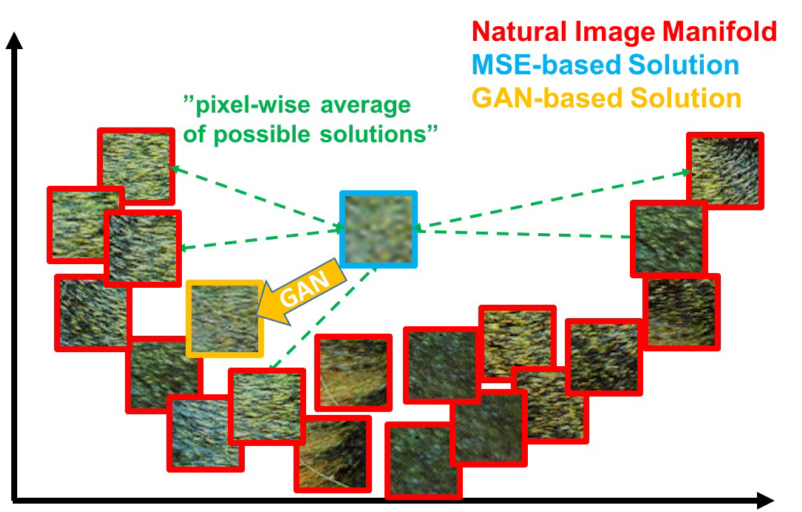

MSE vs GANs
- Unlike most other supervised learning techniques, GANs do not use mean squared error. 
- Given the natural image manifold (red). 
- MSE will averagea over all possible solutions (Blue) resulting in a blurry  and low quality sample. 
- GANs will choose one correct solution out of all correct solutions. 
- Could learn blurry images. 
- When the discriminator recieves any one correct solution, it will prop it up as a good thing, unlike MSE. 
- Image (Ledig et al. 2016)



### Predicting Next Video Frame  (Lotter et al. 2016)

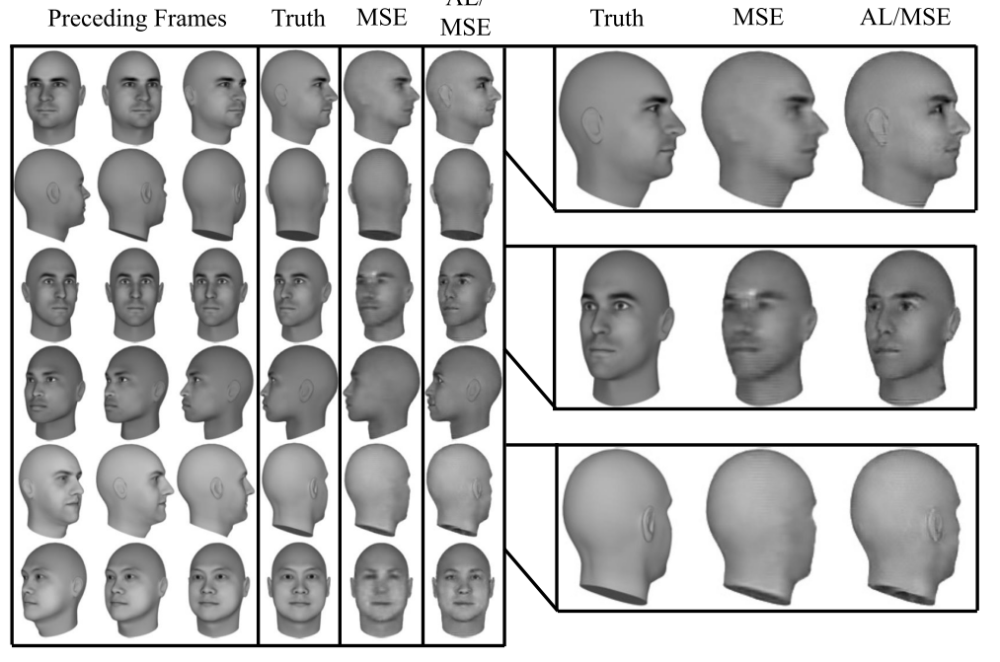

- MSE - the image does not hold much detail as the algorithm blurs over many possible answers
- AL (adverarial loss) Chooses one possible correct solution. Image is sharper. 


# Future Work

### Mode Collapse Problem

- The GAN remains stuck cycling through modes. 
- $\min_G \max_D V(G, D) \neq  \max_D \min_G V(G, D)$

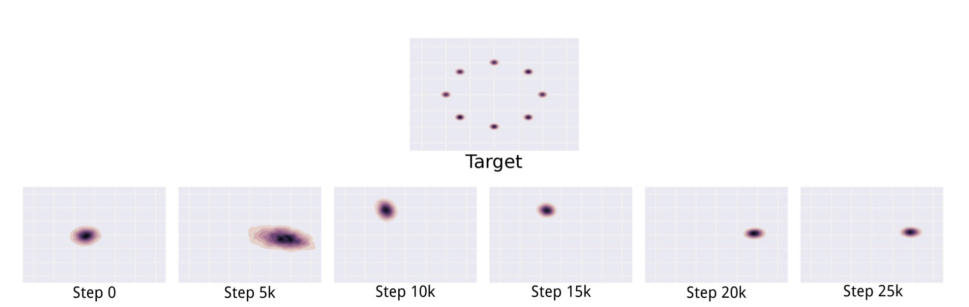



Min Max is not gauranteed. 
- Could also produce max min, which is a result of the simulataneous gradient ascent. 
- Max Min: then the generator tries to minimize the error for a particular set (minibatch) of samples which results in the focus of a single mode. 

Here we can see that at various iterations in the training, different modes are targeted. 
- There has been research for Unrolled GANs by Metx et al. 2016 that look to have minimized this issue. 



### Other Endeavours 

- Other Games: Understand how continuous high-dimensional non-convex games converge
- Evaluation of generative models. 
- Discrete outputs
- Using the latent code $z$

Latent Code has very high level semantic information from the real data distrubution. 
- Not clear how to use this. 

# Questions

# References

## Website


http://www.deeplearningbook.org/contents/generative_models.html
https://affinelayer.com/pixsrv/
https://phillipi.github.io/pix2pix/
https://github.com/goodfeli
https://github.com/damianavila/RISE // Jupyter notebook slide extension
https://github.com/soumith/ganhacks/blob/master/README.md
https://www.youtube.com/playlist?list=PLJscN9YDD1buxCitmej1pjJkR5PMhenTF // 2016 NIPS tutorial
https://github.com/adeshpande3/Generative-Adversarial-Networks // GAN tensortflow
https://www.tensorflow.org/get_started/mnist/pros
https://blog.openai.com/generative-models/
https://deepmind.com/blog/wavenet-generative-model-raw-audio/ // WaveNet
http://distill.pub/2016/deconv-checkerboard/
http://3dgan.csail.mit.edu/ // 3D Gan
http://www.kdnuggets.com/2017/01/generative-adversarial-networks-hot-topic-machine-learning.html
https://github.com/awjuliani/TF-Tutorials // Tensorflow impl for DCGAN
https://jaan.io/what-is-variational-autoencoder-vae-tutorial/



## Papers

Lotter, W., Kreiman, G., & Cox, D. (2016). Unsupervised Learning of Visual Structure using Predictive Generative Networks. ICLR 2016. Retrieved from http://arxiv.org/abs/1511.06380
Ledig, C., Theis, L., Huszar, F., Caballero, J., Cunningham, A., Acosta, A., … Shi, W. (2016). Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network. arXiv:1609.04802, 19. Retrieved from https://arxiv.org/pdf/1609.04802.pdf
White, T. (2016). Sampling Generative Networks. Neural Information Processing Systems, (Nips), 1–11. Retrieved from https://arxiv.org/pdf/1609.04468.pdf
Isola, P., Zhu, J.-Y., Zhou, T., & Efros, A. A. (2016). Image-to-Image Translation with Conditional Adversarial Networks. arXiv, 16. https://doi.org/arXiv:1611.07004
Springenberg, J. T., Dosovitskiy, A., Brox, T., & Riedmiller, M. (2015). Striving for Simplicity: The All Convolutional Net. Iclr, 1–14. https://doi.org/10.1163/_q3_SIM_00374
Nowozin, S., Cseke, B., & Tomioka, R. (2016). f-GAN: Training Generative Neural Samplers using Variational Divergence Minimization. arXiv, 2(1), 17. Retrieved from https://arxiv.org/pdf/1606.00709.pdf
Bengio, Y., Thibodeau-Laufer, É., Alain, G., & Yosinski, J. (2014). Deep Generative Stochastic Networks Trainable by Backprop. International Conference on Machine Learning, 226–234. Retrieved from https://arxiv.org/pdf/1306.1091.pdf
Kingma, D. P., & Welling, M. (2014). Auto-Encoding Variational Bayes. Iclr, (Ml), 1–14. https://doi.org/10.1051/0004-6361/201527329
Lotter, W., Kreiman, G., & Cox, D. (2016). Unsupervised Learning of Visual Structure using Predictive Generative Networks. ICLR. Retrieved from https://arxiv.org/pdf/1412.6980.pdf
Oord, A. van den, Simonyan, K., Kalchbrenner, N., Dieleman, S., Vinyals, O., Senior, A., … Kavukcuoglu, K. (2016). WAVENET: A GENERATIVE MODEL FOR RAW AUDIO, 1–15. https://doi.org/10.1109/ICASSP.2009.4960364
Zhu, J. Y., Krähenbühl, P., Shechtman, E., & Efros, A. A. (2016). Generative visual manipulation on the natural image manifold. In Lecture Notes in Computer Science (including subseries Lecture Notes in Artificial Intelligence and Lecture Notes in Bioinformatics) (Vol. 9909 LNCS, pp. 597–613). https://doi.org/10.1007/978-3-319-46454-1_36
Wang, X. X., Gupta, A., Xue, T., Wu, J., Bouman, K. L., Freeman, W. T., … Belongie, S. (2016). Plug & Play Generative Networks: Conditional Iterative Generation of Images in Latent Space. Cvpr 2016, 9911 LNCS(2014), 424. https://doi.org/10.1109/CVPR.2016.278
Chen, X., Duan, Y., Houthooft, R., Schulman, J., Sutskever, I., & Abbeel, P. (2016). InfoGAN: Interpretable Representation Learning by Information Maximizing Generative Adversarial Nets. arXiv:1606.03657 [cs.LG], (Nips), 1–14. https://doi.org/10.1007/978-3-319-16817-3
Salimans, T., Karpathy, A., Chen, X., & Kingma, D. P. (n.d.). PIXELCNN++: IMPROVING THE PIXELCNN WITH DISCRETIZED LOGISTIC MIXTURE LIKELIHOOD AND OTHER MODIFICATIONS. Retrieved from https://arxiv.org/pdf/1701.05517.pdf
Salimans, T., Goodfellow, I., Zaremba, W., Cheung, V., Radford, A., & Chen, X. (2016). Improved Techniques for Training GANs. Nips, 1–10. https://doi.org/arXiv:1504.01391
Reed, S., Oord, A. van den, Kalchbrenner, N., Colmenarejo, S. G., Wang, Z., Belov, D., & de Freitas, N. (2017). Parallel Multiscale Autoregressive Density Estimation. arXiv. Retrieved from https://arxiv.org/pdf/1703.03664.pdf
Reed, S., Akata, Z., Yan, X., Logeswaran, L., Schiele, B., & Lee, H. (2016). Generative Adversarial Text to Image Synthesis. Icml, 1060–1069. https://doi.org/10.1017/CBO9781107415324.004
Metz, L., Poole, B., Pfau, D., & Sohl-Dickstein, J. (2016). Unrolled Generative Adversarial Networks. Retrieved from https://arxiv.org/pdf/1611.02163.pdf
Makhzani, A., Shlens, J., Jaitly, N., Goodfellow, I., & Frey, B. (2015). Adversarial Autoencoders. Retrieved from https://arxiv.org/pdf/1511.05644.pdf
Salimans, T., Goodfellow, I., Zaremba, W., Cheung, V., Radford, A., & Chen, X. (2016). Improved Techniques for Training GANs. Nips, 1–10. https://doi.org/arXiv:1504.01391
Abadi, M., Agarwal, A., Barham, P., Brevdo, E., Chen, Z., Citro, C., … Zheng, X. (2015). TensorFlow: Large-Scale Machine Learning on Heterogeneous Distributed Systems. None, 1(212), 19. https://doi.org/10.1038/nn.3331
Goodfellow, I. J., Pouget-Abadie, J., Mirza, M., Xu, B., Warde-Farley, D., Ozair, S., … Bengio, Y. (2014). Generative Adversarial Networks. Advances in Neural Information Processing Systems, 2672–2680. Retrieved from http://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf
Radford, A., Metz, L., & Chintala, S. (2015). Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks, 587, A64. Retrieved from https://arxiv.org/pdf/1511.06434.pdfï¼‰
Odena, A. (2016). Semi-Supervised Learning with Generative Adversarial Networks. In ICML (pp. 1–3). https://doi.org/arXiv:1504.01391
Goodfellow, I. (2016). NIPS 2016 Tutorial: Generative Adversarial Networks. https://doi.org/10.1001/jamainternmed.2016.8245